This Jupyter Notebook combines both the writing and high level code to improve reproducibility of the work. You can view the notebook in nbviewer with interactive figures. You can also run the Notebook in the cloud using Binder. If you are already reading this from nbviewer, simply click on the Binder link above in order to open your own cloud computing environment. Please message the corresponding author if any errors appear. 

The two datasets used here are available publicly. We used Valoroso et al. (2020; see http://doi.org/10.5281/zenodo.4036248) for earthquake hypocenter information and Chiaraluce et al. (2021; see http://doi.org/10.5281/zenodo.4024065) for focal mechanisms. 

# Supplementary Notebook for "Three-Dimensional Paganica Fault Morphology Obtained from Hypocenter Clustering (L'Aquila 2009 seismic sequence, central Italy)" 


Brennan Brunsvik<sup>1,2</sup>, Gabriele Morra<sup>1,3</sup>, Gabriele Cambiotti<sup>4</sup>,
Lauro Chiaraluce<sup>5</sup>, Raffaele Di Stefano<sup>5</sup>, Pasquale De Gori<sup>5</sup>, David
A. Yuen<sup>6,7</sup>

\(1) School of Geosciences, University of Louisiana at Lafayette, LA
70504, USA.

\(2) Department of Earth Science, University of California Santa Barbara,
CA 93106, USA.

\(3)  Department of Physics, University of Louisiana at Lafayette, LA
70504, USA.

\(4)  Department of Earth Sciences, University of Milan, Via Cicognara 7,
 20133 Milano, Italy.

\(5)  Istituto Nazionale di Geofisica e Vulcanologia, Via di Vigna
Murata, 605 00143 Rome, Italy

\(6) Dept. of Earth Sciences and Minnesota Supercomputing Institute,
University of Minnesota, Minneapolis, MN 55455, USA

\(7)  Dept. of Applied Physics and Applied Mathematics, Columbia
University, New York, NY 10026, USA

**Corresponding author:** Brennan Brunsvik;
<brennan.brunsvik@gmail.com>; 40 S. Patterson Ave 204, Santa Barbara,
CA, 93111

**Keywords:** fault morphology, clustering, L'Aquila earthquake sequence

**Highlights:**

-   Machine learning can be used for retrieving the 3D morphology of
    faults quickly and objectively.

-   We apply clustering to L'Aquila sequence aftershock hypocenters to
    distinguish which faults they occurred on.

-   We use the clustered hypocenters to invert for the 3D morphology of
    the Paganica fault system.

**Declarations of interest:** none

**Funding:** This research did not receive any specific grant from
funding agencies in the public, commercial, or not-for-profit sectors.



Abstract
========

In seismic modelling, fault planes are normally assumed to be flat due
to the lack of data which can constrain fault morphology. However,
incorporating 3D fault morphology is important for modelling several
phenomena, for example calculating mainshock induced stress changes. We
utilize a data-analytical method to unveil the 3D rupture morphology of
faults using unsupervised clustering techniques applied to
earthquake hypocenters in seismic sequences. We apply this method to the
2009 L'Aquila seismic sequence which involved a M~W~ 6.1 mainshock on
April 6^th^. We use a dataset of about 50,000 relocated events, mostly
microearthquakes, reaching magnitude of completeness equal to 0.7.
Clustering distinguishes the earthquakes as occurring in three main
clusters along with other minor fault segments. We then represent the
morphology of the main Paganica fault system (responsible for the
largest mainshock) using splines. This method shows promise as a step
toward robustly and quickly obtaining 3D rupture morphologies where
earthquake sequences have been monitored. The 3D model is presented
interactively online, and the processing is presented in an interactive
Jupyter Notebook (https://bit.ly/2MnCFdj).


1 Introduction
============

The 3D morphology of fault planes is generally unknown at depth due to
the lack of information which can constrain them. We present an approach
where we use machine learning to find the 3D morphology of faults based
on the spatial distribution of aftershocks in seismic sequences. We
apply this method to model the Paganica fault system which was the
source of the April 6^th^, 2009 M~W~ 6.1 mainshock of the thoroughly
monitored L\'Aquila seismic sequence in the central Apennines, Italy
(Scognamiglio et al., 2010).

This approach to automating the inversion of 3D fault morphology can be
useful in many ways. Inaccuracies in fault morphology can interfere with
earthquake source inversions, resulting in less realistic slip
distributions (Ragon et al., 2018) and affecting coulomb stress
calculations and aftershock forecasts (Kaven and pollard, 2013; Mildon
et al., 2016; Verdecchia et al., 2018; Mancini et al., 2019). In
addition, the morphology of faults influences dynamic stress (e.g.
Pelties et al., 2012; Galvez et al., 2014; Zhang et al., 2014),
earthquake magnitude and location (Barka et al., 1988; Zielke et al.,
2017), tsunami generation (Moore et al., 2007), and other phenomena.
Along megathrusts (e.g. the M~W~ 7.8 2015 Gorkha earthquake, Hubbard et
al., 2016) the determination of the 3D morphology of slabs and faults
has been taken into account (Qiu et al., 2016; Landry and Barbot, 2018).
This can provide information on locked zones (Avouac, 2008; Avouac et
al., 2015), which are crucial to understand as they can promote intense
seismicity. For the major subduction zones of the Earth, it has been
shown that curvature influences earthquake rupture area and magnitude
(Bletery et al., 2016). Ultimately, progress toward automatic and
objective fault reconstruction is an important task in seismology.

A variety of methods are used to estimate fault morphology. Active
source seismology is used to build high resolution fault models (e.g.
Lohr et al., 2008; Røe et al., 2014). This is the case, among others, of
the low angle Altotiberina normal fault in the northern Apennines
(Italy) for which 3D morphology was obtained by merging seismic imaging,
borehole analysis, geologic maps, and field surveys. Unfortunately, the
costs of active source seismology and drilling make this a difficult
option. Fault geometry can also be illuminated from passive source
methods. For example, modelling of seismic waves trapped in low-velocity
damage zones can provide information on fault geometry (Peng et al.,
2003; Ben-Zion et al., 2003; ﻿Calderoni et al., 2012).

The distribution of foreshocks and aftershocks can also provide
information on fault morphology. Analysts can attribute earthquakes to
their source faults by visual inspection of earthquake locations and
surfaces can be fit to the aftershocks to model these faults (e.g.
Carena et al., 2002). The combination of hypocenter interpretation along
with various other data types (e.g. fault traces, borehole data,
geodetic data, geologic cross-sections) has been used to construct 3D
geologic models of faults associated with the L'Aquila sequence
(Lavecchia et al., 2012; Lavecchia et al., 2017; Castaldo et al., 2018)
and the 2016 Amatrice/Visso/Norcia sequence (Lavecchia et al., 2016;
Tung and Masterlark, 2018). While these methods are successful, they
involve qualitative and subjective elements which influence the results
based on the analysts' background. Moreover, it is not quickly
reproducible, particularly in quasi real-time as a seismic sequence
evolves.

On the argument of automation and fast, reproducible data analysis,
machine learning is becoming increasingly useful in Earth science (Kong
et al., 2019; Bergen et al., 2019). Some examples include determining
earthquake magnitudes (Mousavi and Beroza, 2019), analyzing lab quakes
(Rouet-Leduc et al., 2017), and picking phase arrivals (Zhu and Beroza,
2019). Machine learning includes supervised learning which requires
pre-labeled data for training, and unsupervised learning where no
pre-labeled data is required for training. Clustering is one application
of unsupervised machine learning. If data points are distributed in
distinct groups, clustering finds these groups and labels each datum
according to which group it belongs to (e.g. Omran et al., 2007; Joshi
and Kaur, 2013).

There have been several applications of clustering in Earth Science. For
example, it has been applied to earthquake relocation (Trugman and
Shearer, 2017), investigation of earthquake processes and precursors
(Dzwinel et al., 2003; Dzwinel et al., 2005; Yuen et al., 2009), and
distinguishing dominant faulting patterns in focal mechanism data-sets
(Rietbrock et al., 1996; Custódio et al., 2016). Hypocenter locations
have been clustered to establish seismic zones for probabilistic seismic
hazard analysis (Weatherill and Burton, 2009; Ansari et al., 2015;
Novianti et al., 2017; Hall et al., 2018; Scitovski, 2018).

Clustering has also been used to investigate fault geometry based on
hypocenter information (Ouillon et al., 2008; Ouillon and Sornette,
2011; Wang et al., 2013). In these cases, clusters were distinguished by
fitting them with a series of planes. The RANdom SAmple Consensus
(RANSAC) algorithm, which fits a model to the dominant trend in data
while attempting to reject outlier data (Fischler and Bolles, 1981), has
also been used to find faults in hypocenter data and to model them with
3D surfaces (Kaven and Pollard, 2013; Skoumal, 2019). Ultimately,
clustering has the capability to automatically identify groups of
hypocenters common to fault zones to aid in inverting fault morphology
in a quick and objective fashion.

Here, we present an approach based on the unsupervised machine learning
technique clustering which can automate fault identification using
hypocenter locations. We apply our clustering-based method to the
L'Aquila seismic sequence in the central Apennines (Italy) which was
particularly well monitored with over 50,000 high-resolution relocated
aftershocks identified throughout 2009 (Valoroso et al., 2013). This
large amount of data is well suited for data-driven techniques. Further,
the fault morphologies associated with this sequence are relatively
simple, making this a good region to test fault morphology inversion
algorithms.

1.1 2009 L'Aquila Seismic Sequence
----------------------------------

The faults associated with the L'Aquila seismic sequence have been
thoroughly studied (Figures 1 and 2; e.g. Lavecchia et al., 2012;
Valoroso et al. 2013). The L'Aquila sequence activated a dominantly
south-west dipping normal fault system about 50 km long. Aftershocks are
broadly associated with the \~N140° striking Paganica fault system, the
\~N150° striking Campotosto (Gorzano) fault, and a cluster near the
Cittareale village. The mainshock occurred in the Paganica fault system,
which is composed of several enechelon faults extending approximately
from the SE end of the San Demetrio fault system through the Mt.
Stabiata Fault. The Cittareale cluster is composed dominantly of several
NW-SE striking and NE dipping faults, as well as a SW dipping fault
likely associated with the Montereale fault system.

Chiaraluce (2012) provided a review of the 2009 L'Aquila sequence
(Figure 1), which began in approximately January, 2009. The foreshocks
included a M~W~ 4.0 earthquake on March 30th before the April 6^th^ M~w~
6.1 NW-SE striking and SW dipping mainshock (Chiaraluce et al., 2011).
Southeast of the mainshock, on April 7^th^, a M~W~ 5.4 aftershock
occurred on a \~NE dipping fault with a non dip-slip component (rake of
\~58°: see Figure 1 for focal mechanisms of large events) (Scognamiglio
et al., 2010; Valoroso et al., 2013). Campotosto fault seismicity
included a M~W~ 5.0 event on April 6th and M~W~ 5.0 and 5.2 events on
April 9^th^, which were dominantly dip slip, SE to SSE striking, and SW
to WSW dipping (Scognamiglio et al., 2010). These events occurred on the
shallower, steeply dipping portion of the listric Campotosto fault which
appears kinked at its base where seismicity abruptly changes to low dip
(Chiaraluce, 2012). A M~W~ 4.4 event occurred later on June 22^nd^, 2009
beneath this kink, on the gently dipping portion of the Campotosto fault
with nodal planes showing dip of 88° or 14° (Valoroso et al., 2013). On
June 25^th^, a M~W~ 3.5 (Scognamiglio et al., 2010) earthquake occurred
within the Cittareale cluster. This seismic cluster is approximately the
northward extent of the L'Aquila sequence.

Varying terminology has been used to describe the fault system that we
focus on. Many refer to the fault as the "L'Aquila fault system" (e.g.
Chiaraluce et al., 2013), and many others use variations on the "Mt.
Stabiata -- Paganica -- San Demetrio fault system" (e.g. Boncio et al.,
2010; Lavecchia et al., 2012). The mainshock occurred on the L'Aquila
normal fault system, most precisely on the portion corresponding in the
field to the Paganica fault (Chiaraluce et al., 2012). Essentially the
Mt. Stabiata, Mt. Castellano, Colle Enzano, Paganica, and San Demetrio
faults can be viewed as part of the same semi-continuous fault system
(Figure 1; Civico et al., 2017). However, it must be recognized that the
relationship between outcropping faults and hypocenters can be complex
(e.g. Tondi, 2000), and our goal is to more generally model the
morphology of the fault zone where it was either coseismically activated
by the mainshock or is continuous with the coseismically activated
portion of the fault zone. For this reason, and to emphasize the
relation of the modelled fault to the mainshock, we call the system the
"Paganica fault system" to emphasize the importance of the mainshock.

In [39]:
# THIS CELL CHOOSES HOW TO RUN THE NOTEBOOK. THE OTHER CELLS CAN BE BASICALLY LEFT ALONE.
runAllFigures = True
savePlotlyFigures = False

# For loading saved values. 
variable_folder = "stored_variables/"
slip_dist_folder = 'slip_dist/'

In [40]:
# Import plotly stuff
from plotly.offline import plot
import plotly.graph_objs as go
import PIL.Image # required for some image manipulation
from IPython.display import clear_output# required for some image manipulation
from plotly.offline import download_plotlyjs, init_notebook_mode
init_notebook_mode(connected=True)

#Import builtin
import os
import sys
import time
from datetime import datetime, date, time
import copy
import json

#sci and num py
import numpy as np
import scipy.optimize as optimize
from scipy.optimize import least_squares
from scipy.interpolate import Rbf
from scipy import interpolate
import scipy
import scipy.io as sio
from numpy.linalg import norm
from numpy.linalg import inv

import pandas as pd
    
## visualization
# matplotlib
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse
import matplotlib.patches as patches
from matplotlib.ticker import AutoMinorLocator
import matplotlib.mlab as mlab
import matplotlib
from mpl_toolkits.mplot3d import Axes3D
from scipy.spatial import ConvexHull
import matplotlib.path as mpltPath
from matplotlib.patches import FancyArrowPatch
from mpl_toolkits.mplot3d import proj3d
from matplotlib.colors import ListedColormap 



from scipy.spatial import Delaunay
import matplotlib.cm as cm
from functools import reduce

from IPython.display import Image
##

# For clustering
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import sklearn.mixture
import multiprocessing #!# may not need multiprocessing
import sklearn

# pyproj handles UTM projection
import pyproj

sys.path.append('geo_data')


In [41]:
# load some other notebooks. Some were built fore other purposes but have useful functions for this work. 

# Functions for loading data. 
%run ./Load_Data.ipynb

# Get functions that are used for many mathematical calculations. Open that file for details. 
%run ./Calculation_Functions.ipynb

# Functions for fault splitting 
%run ./Fault_Splitting.ipynb 

# Get some fundamental functions for making figures. Open that file for details. 
%run ./Figure_Making_Functions.ipynb

# Get clustering info
%run ./clustering_base_file.ipynb

# Get some stress related stuff
%run ./stress_base_file.ipynb 

# Functions to aid in 3d plotting. 
%run ./plots3d.ipynb

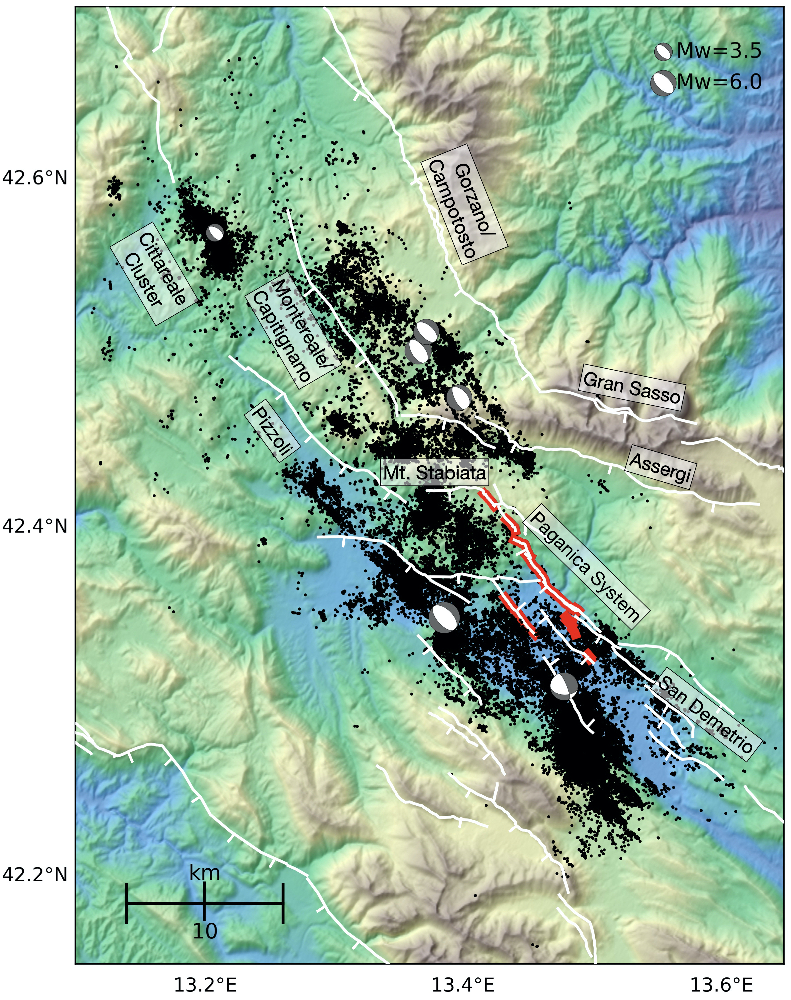

## Figure 1. 
Map view of seismicity of the L'Aquila seismic sequence.
Hypocenters are from Valoroso et al. (2013). Fault traces and surface
ruptures are modified from Boncio et al. (2010) and Valoroso et al.
(2013). Fault and fault system names discussed in the text are labeled
(names do not refer to city locations). Normal fault dip directions are
indicated by barbs. Focal mechanisms are plotted for events with M \>= 5
in addition to the M~W~ 3.5 event in the Cittareale area (Scognamiglio
et al., 2010).

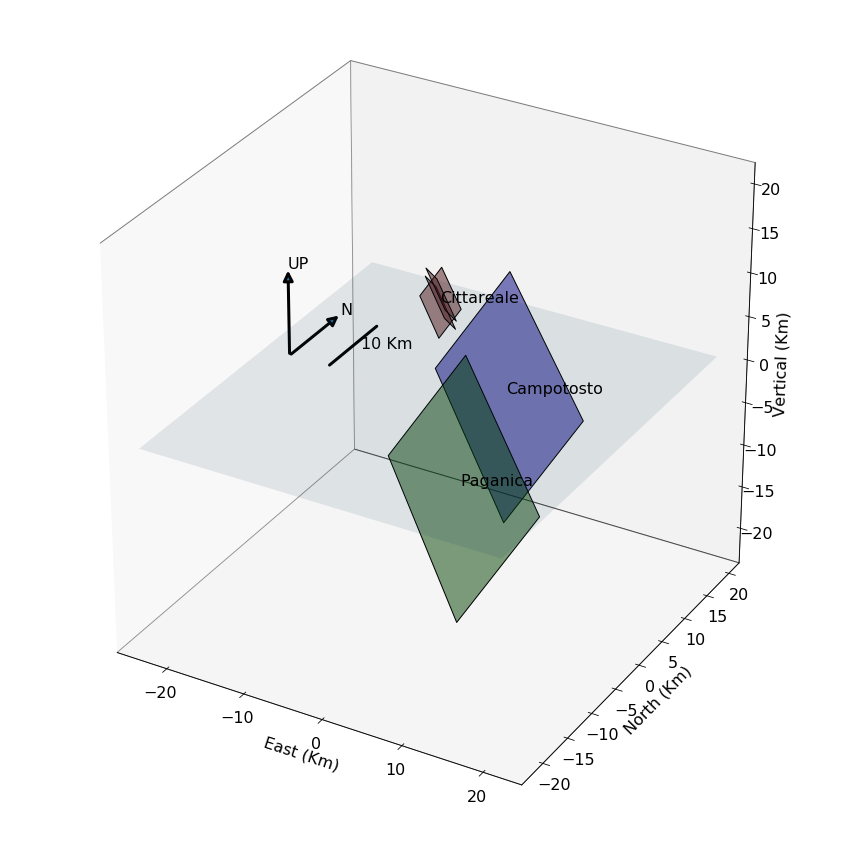

In [42]:
make_schematic_plot()

## Figure 2. 
Simplified schematic of the dominant hypocenter clusters
involved in the L'Aquila sequence. Seismic activity occurred dominantly
in a cluster about the Paganica fault system (including from the Mt. San
Franco fault through the San Demetrio faults), the Campotosto cluster,
and the Cittareale cluster (consisting of conjugate faults in part
corresponding to the Montereale fault system).

# 2 Methods 

The aim of the proposed method is to use aftershock locations to invert
for fault morphology in an objective, automated way. For this method, it
is first necessary to group aftershocks according to the faults they
occurred on. Then the 3D morphology of a specific group of aftershocks
can be inverted using splines (Virtanen et al., 2020). The reader is
referred to the Supplementary Jupyter Notebook which presents the
methods and results interactively (https://bit.ly/2MnCFdj).

The first step is to apply clustering to hypocenters. Then, hypocenter
clusters can be associated with source faults (similar to Ouillon et
al., 2008). Note that because this method relies on the occurrence of
earthquakes, faults which are not activated or are only partially
activated will not be fully accounted for. To increase the quality of
the results, we run two iterations of clustering: one with spectral
clustering (Von Luxburg, 2007), and another with Density-Based Spatial
Clustering of Applications with Noise (DBSCAN) (Ester et al., 1996).
Finally, after clusters of hypocenters are categorized according to
their source faults, we focus on specifically the Paganica fault system
for which we interpolate a continuous 3D surface.

We use the earthquake catalog of Valoroso et al. (2013). The catalog was
generated by applying STA/LTA event detection, applying an automated
phase arrival picking procedure, removing duplicate events,
cross-correlating records of event pairs, and finally applying the
double-difference relocation algorithm *hypoDD* (Waldhauser and
Ellsworth, 2000). Based on 95% confidence intervals obtained from a
bootstrap analysis, the authors estimated mean location errors of 0.087,
0.178, and 0.039 km in the vertical and two horizontal directions,
respectively.

## 2.1 Application of clustering to identify faults 

The machine learning clustering approach attempts to find relationships
in data based on their similarity. In our case, where the locations of
different earthquakes are sufficiently close, clustering can recognize
that these earthquakes occurred on the same fault. If the earthquakes
are sufficiently distant from each other, clustering can recognize that
the earthquakes occurred on different faults. Several challenges arise
using this approach. Where faults intersect, hypocenters of different
faults can be close to each other and clustering algorithms can be blind
to this. Further, aftershock location inaccuracy is inevitably present
due to imperfect knowledge of crustal 3D velocities and elastic
properties. Thus, hypocenters tend to erroneously appear between
multiple faults, and to which fault these hypocenters belong to is
unclear. To mitigate this, clustering is done in two iterations; first
with a spectral method, and second with DBSCAN.

During the first clustering iteration, we used the spectral clustering
algorithm of Scikit-Learn (Pedregosa et al., 2011). Von Luxburg (2007)
provided an overview of spectral clustering. Spectral clustering is
appropriate because it works well for non-convex clusters (a cluster is
non-convex when a line drawn between two points can escape the cluster,
such as hypocenters belonging to a curved fault). We first compute the
similarity matrix between points which defines clustering weights
according to the distance between hypocenters:
$\mathbf{s}_{\mathbf{i,j}} = \exp( - {\parallel \mathbf{x}_{\mathbf{i}} - \mathbf{x}_{\mathbf{j}} \parallel}^{2}/2\sigma^{2})$,
where $\mathbf{x}_{\mathbf{i}}$ and $\mathbf{x}_{\mathbf{j}}\ $ are the
positions of the *i*th and *j*th hypocenters, and $\sigma$ is the width
of the gaussian kernel. Then, the normalized Laplacian matrix is
constructed: $\mathbf{L}\, = \,\mathbf{D}\, - \,\mathbf{W}$.
$\mathbf{W}$ is the weighted adjacency matrix of each point. We use
$\mathbf{W} = \mathbf{s}$. The degree matrix $\mathbf{D}$ is a diagonal
matrix containing the degrees of the weight vector
$d_{i} = \Sigma_{j = 1}^{n}w_{i,j}$. Then, the first $k$ eigenvectors
$\mathbf{u}_{\mathbf{1}},\ldots,\mathbf{u}_{\mathbf{k}}$ of $\mathbf{L}$
are computed to construct $\mathbf{U} \in R^{n \times k}$. Finally, in
$k$-dimensional space, the $n$ points within $\mathbf{U}$ are assigned
labels using k-means.

For the spectral clustering application, we used only the 542
earthquakes with M~L~ \>= 2.3 (Table 1). This helps to remove small
aftershocks that blur the distinction between different faults. It also
makes the memory demanding spectral clustering algorithm more
manageable. Spectral clustering, like many other clustering algorithms,
requires prior knowledge of the number of clusters. We choose $k = 3$,
corresponding to the Paganica, Campotosto, and Cittareale clusters
(Table 1). Note that this choice of $k = 3$ only applies to the spectral
clustering step: the number of clusters found during the later
application of DBSCAN will be independent. Finally, we choose
$\sigma = 2000$ m (Table 1). However, for
$1250\ \mathrm{m} < \sigma < \ 4300\ \mathrm{m}$, the results vary only
negligibly. This spectral clustering step separated the hypocenters into
three dominant clusters (Figure S1).

  Method                | Spectral  | DBSCAN  | Splines
  ----------------------| ----------| --------| ---------
  M_min~                | 2.3       | None    | 
  Number of earthquakes | 542       | 51339   | 
  Number of clusters    | 3         | 9       | 
  Eps                   |           | 2 km    | 
  σ                     | 2 km      |         | 
  MinPts                |           | 80      | 
  f                     |           | 5       | 
  dx1                   |           |         | 5668 m
  dx2                   |           |         | 2544 m

## Table 1. 
Parameters and properties for the two clustering methods.
M~min~ is the minimum magnitude of events used for that step; we also
report the number of remaining earthquakes. We report the number of
clusters. This was specified as a parameter for the Spectral clustering
step only, while the number of clusters reported for DBSCAN was a result
of the method. Eps and MinPts are specified parameters for the DBSCAN
step only, and σ is specified for Spectral clustering only.
$\text{\ f\ }$is the stretching factor which was applied to hypocenters
prior to applying DBSCAN. dx1 and dx2 describe the horizontal and
vertical spacing of nodes for the spline inversion.

In [43]:
## Start spectral clustering

# Load data
allHypo = hypoData(minMag=None)
allHypo.labels=np.zeros(allHypo.mL.size)  
    
# Spectral clustering
sp = spClust()
sp.minMag=2.3 # Only use earthquakes with greater than minMag
sp.getHypocenters()

sp.assign_labels="kmeans" # How to assign labels during last step of spectral clustering
sp.n_init=50 # Initialized 50 times to get valid results
sp.n_clusters=3 # Choose number of clusters. 
sp.sigma = 2000 # Describes the width of clusters. 

sp.cluster() # Apply clustering
# spectral clustering is completed 
# sp.labels indicates cluster identities


## Options for plotting and saving plots. 
if runAllFigures:
    fig2 = plot3dclusters(sp.x, sp.y, sp.z, sp.labels, # Make 3d plot
                   sp.latCent, sp.lonCent, color_option = 1, 
                   faulttraces3d=True)

    if savePlotlyFigures:
        im = save_3d_spectral(fig2, 's1')

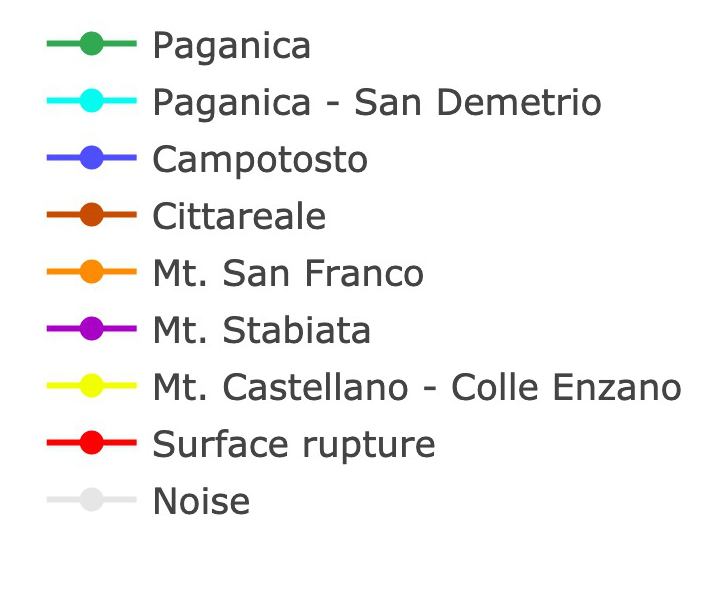

In [44]:
add_legend_plotly()

## Figure S1. 
This shows the results of spectral clustering. The clusters
are colored according to their most closely associated fault segments.
The legend indicates fault trace identities.


Before applying the second clustering iteration, we modify the
hypocenter data to enhance fault like trends. Using the 396 hypocenters
which were preliminarily identified as corresponding to the Paganica
fault system using spectral clustering, we solve for a least squares
distance best fit plane. The positions of all 51339 hypocenters, which
includes those outside of the Paganica cluster, were then stretched by a
factor $f = 5$ in the direction normal to the best fit plane (Table 1).
$f$ is chosen to enhance planar trends in the hypocenters, particularly
those matching the Paganica fault's strike and dip. This preliminary
operation only minimally influences hypocenters close to the fault
surface identified by the best fit plane, while deviations of
earthquakes far from this surface are amplified. With these Paganica
fault-like planar trends more pronounced and bias from deviant
earthquakes reduced, clustering algorithms are much more successful at
both recognizing the full extent of faults and keeping neighboring
faults separate. This step also reduces the problem that some groups of
hypocenters may lie along the same fault, but there are so few
hypocenters between these groups that clustering algorithms normally
find them as separate clusters. This spatial modification also allows
for the use of less computationally expensive clustering methods.

Once DBSCAN is applied during a later step, the results for the Paganica
fault system can be closely matched without applying $\text{f\ }$given
careful tuning of other clustering parameters (Figure S2). However,
without applying $f,$ we observe that clustering will be less successful
when considered over the entire seismic sequence. For example, for
$f = 1$, we find no combination of DBSCAN parameters which both work
well for the Paganica fault while simultaneously distinguishing the
Campotosto fault from the Mt. San Franco fault. For $f > 5$, we do not
observe further improvement to clustering.

With preparatory data operations completed, the final clusters can be
generated using DBSCAN (Ester et al., 1996; Pedregosa et al., 2011;
Schubert et al., 2017). Intuitively, DBSCAN finds dense clusters of
points which are separated by regions of low point density. The two
important parameters are MinPts and Eps which essentially control the
number of points in clusters and the width of clusters, respectively.
DBSCAN relies on the distinction of core points, border points, and
noise. A point *p* is considered a core point if there are greater than
MinPts points *q* with dist(*p,q*) less than Eps. Such points *q* are
considered direct density-reachable from *p* and are thus established as
part of the same cluster. A point *q* that does not qualify as a core
point, but with dist(*p,q*) *\<* Eps, is considered a border point in
the same cluster as the core point *p*. A point *p~n\ ~*is considered
density reachable from each core point *p~j\ ~*in the chain
*p*~1~*,p*~2~*\...p~n\ ~*if each core point in the chain is direct
density reachable to the core point before it; that is, if *p~i~*~+1~ is
direct density-reachable from *p~i\ ~*for 1 *\< i \< n*−1. Note that
*p~n\ ~*itself can be either a core point or border point. This allows
for the growth of clusters by density reachability where all density
reachable points from the core point *p* are part of the same cluster. A
point *q* with dist(*p~j~,q*) *\>* Eps to all core points *p~j\ ~*is
considered noise. Thus, a cluster is composed of core points *p* and
their density reachable border points *q*. We empirically found that Eps
= 2 km and MinPts = 80 (Table 1) are good choices for the Paganica fault
system. However, based on a grid search of Eps and MinPts, the DBSCAN
clustering results for this fault are only negligibly sensitive to Eps
and MinPts (Figure S3).

The result of DBSCAN is that hypocenters are grouped and established as
clusters (Figure 3). Then, we identify the hypocenter clusters according
to which previously geologically identified faults they most closely
correspond to (Figure 3). We discuss the relationship of geologically
identified faults and hypocenter clusters in the results section.

In [45]:
# Make a best fit plane to the cluster containing the mainshock. Then stretch hypocenters away from it. 
laqFault = sp.labels == sp.labels[np.argsort(sp.mL)[-1]] # Identify l'aquila (Paganica) fault as having highest magnitude aftershock

x = sp.x[laqFault]
y = sp.y[laqFault]
z = sp.z[laqFault]
mL = sp.mL[laqFault]
strikeHyp = sp.st1[laqFault]
dipHyp = sp.dp1[laqFault]
strike2Hyp = sp.st2[laqFault]
dip2Hyp = sp.dp2[laqFault]

focalBool = (~( (sp.st1==0) * (sp.st2==0) * (sp.dp1==0)
               * (sp.dp2==0) * (sp.rk1==0) * (sp.rk2==0) ))[laqFault] # is part of L'aquila cluster

splineNodesLine = 7 # spline nodes in each row and collumn

# exclude points over 10km from plane (probably are none). Do rms fit. 
laqPlane = interp(x, y, z, 
               strikeHyp=strikeHyp, dipHyp=dipHyp, strike2Hyp=strike2Hyp, dip2Hyp=dip2Hyp,focalBool=focalBool,
               eps=.1, magnitudeWeight=mL, minPlaneDist = 10000,exp=2,
               splineNodesStrike = splineNodesLine, splineNodesDip = splineNodesLine)



# Prepare for second clustering attempt by "stretching" hypocenters.
db2 = dbClust() # Initialize db scan clustering object. 
db2.minMag=None # Load data. Use all earthquakes
db2.getHypocenters()
db2.geogToMet() # 

# p is vector of points.
db2.p = rotateUniVec(db2.p-np.array([laqPlane.xC,laqPlane.yC, laqPlane.zC]),
    laqPlane.strikeHat, laqPlane.dipHat, laqPlane.normalHat)

# stretch points away from plane, but not along plane. 
stretching_factor = 5
db2.p[:,2]*=stretching_factor

# distances from plane in new coordinate system
distEach = np.abs(distFromPlane(db2.x, db2.y, db2.z, 
                                laqPlane.xC, laqPlane.yC, laqPlane.zC, 
                                laqPlane.normalHat[0], laqPlane.normalHat[1], laqPlane.normalHat[2]))

# We get a warning regarding matrix deficiency, but this is not relevant to the aquired results.

/Users/brennanbrunsvik/anaconda3/envs/fault_morph/lib/python3.7/site-packages/scipy/interpolate/fitpack2.py:1126: UserWarning:


The coefficients of the spline returned have been computed as the
minimal norm least-squares solution of a (numerically) rank deficient
system (deficiency=85). If deficiency is large, the results may be
inaccurate. Deficiency may strongly depend on the value of eps.



In [46]:
### Can use this cell to run the grid search for DBSCAN parameters. 
### That code is not maintained. It can be found in a function at the end of clustering_base_file.ipynb
### runDbscanParameterSearch()

In [47]:
# Decide dbscan parameters
db2.eps=2.0* 1e3
db2.min_samples=80
db2.fitdbscan() # cluster in modified axis system

In [48]:
# Plot results of dbscan
if runAllFigures:
    # Use color_option == 2 for pre_determined hypocenter cluster colors
    # Use color_option == 4 if you change dbscan settings, and then each clusters color is randomly assigned
    color_option = 2 if ((db2.eps == 2.0 * 1e3) and (db2.min_samples == 80)) else 4
    
    pointSize = 4*np.ones(db2.x.shape)
    pointSize[db2.labels == -1] = 3 # decrease size of noise points. 
    
    fig2 = plot3dclusters(db2.x, db2.y, db2.z, db2.labels, # New plot style, 2020.08.14
                   db2.latCent, db2.lonCent, color_option = color_option, 
                   faulttraces3d=True, pointSize=pointSize )

    if False or savePlotlyFigures:
        im = save_3d_db(fig2, 'db')
        fig2.write_html('figures/fig1.html')

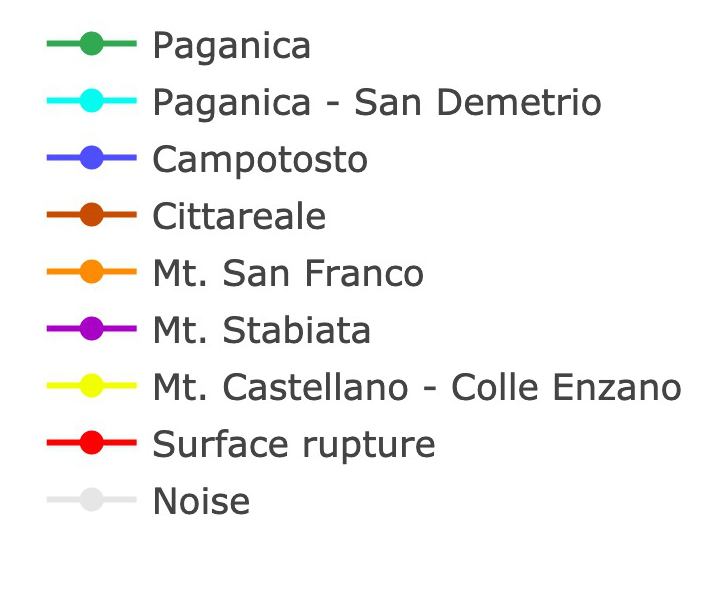

In [49]:
add_legend_plotly()

## Figure 3. 
Also available interactively online (see supplementary
material or at [https://bit.ly/3k7ykqg](https://bit.ly/3i1epZu)).
Looking northwest (a) and southwest (b). Final results from clustering
hypocenters from the L'Aquila seismic sequence. Spectral clustering was
first used to find three primary clusters. DBSCAN was then used on all
hypocenter location data. The gray dots were considered by DBSCAN to be
noise. Three hypocenter clusters are colored according to potentially
affiliated geological fault traces: the Paganica fault, Campotosto
fault, and Mt. San Franco fault. We plot the individual Paganica fault
trace as green, though our Paganica cluster represents Paganica fault
system including faults between the Mt. Stabiata and San Demetrio
faults. The Cittareale cluster, containing several faults, is colored
brown. Other clusters were found for which we do not consider their
relationship to known fault outcroppings, and these are colored
randomly.# Only worry about this cell if clustering labels have changed or if hypocenter dataset changed. 
# Store dbscan results to keep track of which labels correspond to which faults
if False: # This is only used so that we can decide which clusters (labels) belong to which fault. Re-running might mean we have to manually reselect the label of each fault. 
    import pickle
    class empty:
        pass
    hypo_faults = {'Paganica'      :db2.labels==0,
                    'Campotosto'    :db2.labels==1,
                    'Cittareale'    :db2.labels==7,
                    'Mt. San Franco':db2.labels==3,
                    'Noise'         :db2.labels==-1}
    pickle.dump(hypo_faults, open('stored_variables/preliminary_clusters','wb'))
    dbs = empty()
    [dbs.lon, dbs.lat, dbs.labels, dbs.mL, dbs.st1, dbs.st2, dbs.dp1, dbs.dp2, dbs.rk1, dbs.rk2] = [
     db2.lon, db2.lat, db2.labels, db2.mL, db2.st1, db2.st2, db2.dp1, db2.dp2, db2.rk1, db2.rk2]
    pickle.dump(dbs, open(variable_folder+'dbresults', 'wb'))

## 2.2 Inversion of Paganica fault system morphology model

Hypocenters within individual clusters can next be spatially
interpolated to find a best fit 3D fault surface. Although we identified
several hypocenter clusters, this work focuses on modelling the
morphology only of the Paganica fault system. Assuming the aftershocks
in the Paganica hypocenter cluster are distributed in a damage zone and
are approximately symmetric about the Paganica fault system surface
(Valoroso et al., 2013), a least squares best-fit surface will represent
the average rupture location and thus closely resemble the fault
surface.

We interpolated the hypocenters of the Paganica cluster using splines.
We choose splines because high-order polynomials tend to suffer from
unrealistic oscillations between interpolated data whereas splines can
converge to a solution using stable, low-order polynomials (e.g.
Fornberg and Zuev, 2007). The spline algorithm constructs a piece-wise
polynomial which is continuous and smooth. To apply splines, we choose a
coordinate system that is defined by the best fit plane to the Paganica
hypocenter cluster where x~1~' faces along strike to the southeast,
x~2~' faces down dip along the fault plane, and x~3~' faces the hanging
wall, normal to the fault plane (Figure 4). We use 4th order bivariate
B-splines (Prautzsch et al., 2002; Virtanen et al., 2020) defined over
the region 0 *\<*= *x*~1~ *\<*= 15*.*2 km and 0 *\<*= *x*~2~ *\<*=
34*.*0 km which contains all identified Paganica hypocenters. We
distribute throughout the plane a grid of nodes with spacing of *dx*~1~
= 5668 m, and *dx*~2~ = 2544 m (Figure 4; Table 1)*.* In order to have
4th order splines defined through the fault model, exterior nodes must
also be used; these are distributed at distances of ½ *dx*~1~ and ½
*dx*~2~ outside of our fault model (Figure 4). However, the style of
exterior nodes implementation is not important for our results. Finally,
the spline coefficients are inverted using least squares to minimize the
distance between the hypocenters and the spline surface. The resulting
splines indicate the best fit fault surface model of the Paganica
hypocenter cluster (Figure 4).

In [50]:
# start preparing to invert for a surface representing the paganica fault cluster

# Create boolean showing which quakes are in L'Aquila cluster
# Then create boolean of those for which focal mechanisms are available
main_ind = np.argsort(db2.mL)[-1] # db2.mL == np.amax(db2.mL) # Can choose 3rd largest quake to look at Campotosto fault
pagan_lab = db2.labels[main_ind]
booLaqdb = db2.labels==pagan_lab

allPoints = hypoData(minMag=None)
allPoints.getHypocenters()

x2 = allPoints.x[booLaqdb]
y2 = allPoints.y[booLaqdb]
z2 = allPoints.z[booLaqdb]
st1 = allPoints.st1[booLaqdb]
st2 = allPoints.st2[booLaqdb]
dp1 = allPoints.dp1[booLaqdb]
dp2 = allPoints.dp2[booLaqdb]
focalbooLaqdb = (~( (allPoints.st1==0 ) * (allPoints.st2==0 ) * (allPoints.dp1==0 )
  * (allPoints.dp2==0 ) * (allPoints.rk1==0 ) * (allPoints.rk2==0 ) ))[booLaqdb]

In [51]:
splineNodesLine = 7 # nodes per row or collumn in splines
cutPoints = True # convex hull. 

# surface is object for spline interpolation
surface = interp(x2, y2, z2,
               strikeHyp=st1, dipHyp=dp1, strike2Hyp=st2, dip2Hyp=dp2, focalBool=focalBool,
               eps=.1, minPlaneDist = None,exp=2,
               splineNodesStrike = splineNodesLine, splineNodesDip = splineNodesLine, 
               cutPoints = cutPoints, smooth = None)

surface.latCent, surface.lonCent = [db2.latCent, db2.lonCent] # Quick and dirty way of keeping track what lat and lon are at the center of our coordinate system. needed for plotting 3d fault traces. 2020.08.03
surface.focalAvailable=focalbooLaqdb

/Users/brennanbrunsvik/anaconda3/envs/fault_morph/lib/python3.7/site-packages/scipy/interpolate/fitpack2.py:1126: UserWarning:


The coefficients of the spline returned have been computed as the
minimal norm least-squares solution of a (numerically) rank deficient
system (deficiency=97). If deficiency is large, the results may be
inaccurate. Deficiency may strongly depend on the value of eps.



/Users/brennanbrunsvik/anaconda3/envs/fault_morph/lib/python3.7/site-packages/matplotlib/figure.py:98: MatplotlibDeprecationWarning:


Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.



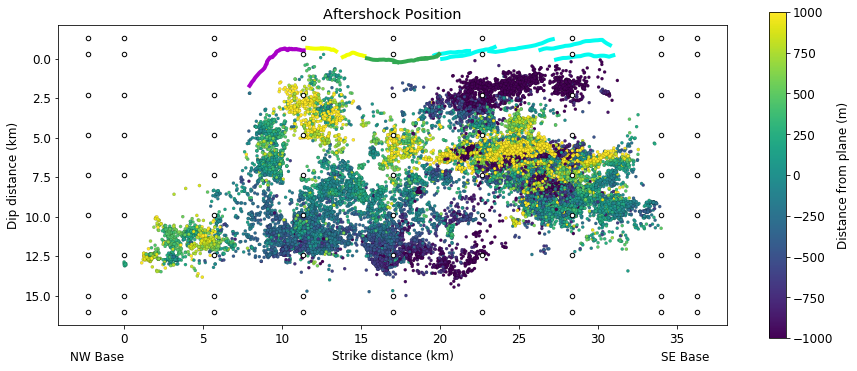

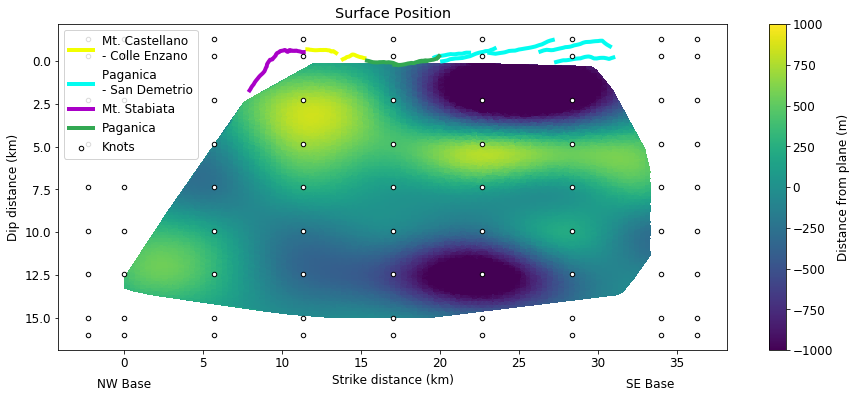

In [52]:
# Figure 4 start. 

def add_traces_2d():
    try:
        thing = pickle.load(open('geo_data/traceinfo', 'rb'))
        fault_color_dict = thing['fault_color_dict']
        trace_to_label = thing['trace_to_label']

        mf, sr = load_fault_traces(mffile = 'geo_data/Mapped_Faults', srfile = 'geo_data/Surface_Ruptures')

        for ifault, fault in enumerate(mf):
            yf, xf = ChangeAxis(surface.latCent, surface.lonCent, fault['lats'], fault['lons'])
            faultS, faultD, __ = surface.forwardRotation(np.array([xf, yf, fault['elv']]).T)
        #     if np.amax(np.abs(__)) > 2000:
        #         continue
            fault_name = trace_to_label.get(fault['name'],'not present')
            color = fault_color_dict.get(fault_name, '#000000')
            if not fault_name in ['Paganica', 'Mt. Stabiata', 'Mt. Castellano - Colle Enzano', 'Paganica - San Demetrio']:
                continue
            faultS = (faultS - np.amin(surface.pS))/1000
            faultD = (faultD - np.amin(surface.pD))/1000
            if fault_name == 'Paganica':
                zorder = 12
            else:
                zorder = 11
            plt.plot(faultS, faultD, color = color, zorder = zorder, linewidth = 4)
    except:
        pass

surface.gridNodesStrike = 100
surface.gridNodesDip = 80
surface.splineInterp(cutPoints=True)
cbarmin = -1e3
cbarmax = 1e3

matplotlib.rcParams.update({'font.size': 12})
plt.figure(figsize=(15,6))

add_traces_2d()

nodes, noded = np.meshgrid(surface.knotS - np.amin(surface.pS), surface.knotD- np.amin(surface.pD)) 
nodes, noded = np.meshgrid(np.unique(surface.spline.get_knots()[0]) - np.amin(surface.pS), np.unique(surface.spline.get_knots()[1])- np.amin(surface.pD)) 
nodes *= 1/1000; noded *= 1/1000
plt.scatter(nodes, noded, s = 20, c = 'white', linewidth = 1, edgecolors='k', zorder = 12.5 )


xplot = (surface.pS-np.amin(surface.pS))/1000
yplot = (surface.pD-np.amin(surface.pD))/1000
#pS and pD are point (hypocenter) position in coordinate system of (strike, dip, normal)
plt.scatter(xplot, yplot, 
            c = surface.pN, vmin = cbarmin, vmax = cbarmax, 
            s = 10, linewidths = .1, edgecolor = 'k') 



plt.title('Aftershock Position')
plt.xlabel('Strike distance (km)')
plt.ylabel('Dip distance (km)')
cbar = plt.colorbar()
cbar.set_label('Distance from plane (m)')
plt.axes().set_aspect('equal')

shiftylabel = -3.5
plt.text(np.amin(xplot), np.amin(yplot)+shiftylabel, 'NW Base', 
         verticalalignment = 'top',
         horizontalalignment = 'right')
plt.text(np.amax(xplot), np.amin(yplot)+shiftylabel, 'SE Base', 
         verticalalignment = 'top',
         horizontalalignment = 'left')

ax = plt.gca()
ax.set(xlim = (-4.197219291376117, 38.20489992788256), ylim = (-1.8905988832845166, 17.15863323378141))
xlim = ax.get_xlim()
ylim = ax.get_ylim()

labels = ax.get_yticks().tolist() # Manually flip the yaxis so the origin is at top of fault, not bottom
labels.reverse()
ax.set_yticklabels(labels)
plt.savefig('figures/dist_scatter.jpg', dpi = 400)
plt.show()

plt.figure(figsize=(15,6))

add_traces_2d()


nodes, noded = np.meshgrid(surface.knotS - np.amin(surface.pS), surface.knotD- np.amin(surface.pD)) 
nodes, noded = np.meshgrid(np.unique(surface.spline.get_knots()[0]) - np.amin(surface.pS), np.unique(surface.spline.get_knots()[1])- np.amin(surface.pD)) 
nodes *= 1/1000; noded *= 1/1000
plt.scatter(nodes, noded, s = 20, c = 'white', linewidth = 1, edgecolors='k', zorder = 12.5, label = 'Knots')

ax = plt.gca()
ax.set(xlim = xlim, ylim = ylim)
xmin = 0
ymin = 0
xmax = (np.amax(surface.interpD) - np.amin(surface.interpD))/1000
ymax = (np.amax(surface.interpS) - np.amin(surface.interpS))/1000


xplot = (surface.interpS-np.amin(surface.interpS))/1000
yplot = (surface.interpD-np.amin(surface.interpD))/1000
zplot = surface.interpN
tri = plt.tripcolor(xplot, yplot, zplot)
tri.set_clim(cbarmin, cbarmax)
cbar = plt.colorbar()
cbar.set_label('Distance from plane (m)')
plt.title('Surface Position')
plt.xlabel('Strike distance (km)')
plt.ylabel('Dip distance (km)')

plt.text(ymin, xmin+shiftylabel, 'NW Base', 
         verticalalignment = 'top',
         horizontalalignment = 'center')
plt.text(ymax, xmin+shiftylabel, 'SE Base', 
         verticalalignment = 'top',
         horizontalalignment = 'center')

ax = plt.gca()
labels = ax.get_yticks().tolist() # Manually flip the yaxis so the origin is at top of fault, not bottom
labels.reverse()
ax.set_yticklabels(labels)

for ifault, faultname in enumerate(['Mt. Castellano \n- Colle Enzano',
                                    'Paganica \n- San Demetrio',
                                    'Mt. Stabiata',
                                    'Paganica',  
                                    ]):
    plt.plot([0,0], [0,0], linewidth = 4, label = faultname, color = fault_color_dict[faultname.replace('\n', '')])

plt.legend(loc = 2, framealpha=0.86).set_zorder(13)
plt.savefig('figures/dist_surf.jpg', dpi = 400)
plt.show()

## Figure 4. 
(a) 2D representation of the aftershocks that were part of the
Paganica fault cluster, and (b) the surface that interpolates them.
Position is shown on the best-fitting plane to the hypocenters where
strike distance corresponds to $x_{1}^{'}$. The y axis corresponds to
distance along dip, not depth, and corresponds to $x_{2}^{'}$. Color
represents distance in meters from the best fitting plane on which
spline knots were distributed (distance in x'~3~). Selected fault traces
are shown as their projection onto the same plane. The viewing angle is
such that the viewer looks northeast and down.

In [53]:
# Figure 5. 
surface_coarse = copy.deepcopy(surface) # Make a coarse representation of surface: looks better with the wireframe figure that way. 
surface_coarse.gridNodesStrike = 25
surface_coarse.gridNodesDip = 20
surface_coarse.splineInterp(cutPoints=True)

if runAllFigures:
    fig2 = plot3dclusters(db2.x[booLaqdb], db2.y[booLaqdb], db2.z[booLaqdb], db2.labels[booLaqdb], # New plot style, 2020.08.14
               db2.latCent, db2.lonCent, color_option = 2, 
               interpX = surface_coarse.interpX, interpY = surface_coarse.interpY, interpZ = surface_coarse.interpZ, 
               interpS = surface_coarse.interpS, interpD = surface_coarse.interpD,
               faulttraces3d=True, pointSize=pointSize/2.5 , faultcolors = False)

    if False or savePlotlyFigures:
        im = save_3d_surf(fig2, 'surf')
        fig2.write_html('figures/fig2.html')



## Figure 5. 
Also available interactively (see supplementary material or
online at [https://bit.ly/3k7ykqg](https://bit.ly/3i1epZu)).
Interpolated fault surface compared to locations of hypocenters in our
Paganica fault system model. We plot the individual Paganica fault trace
as green, though our Paganica fault model represents the whole Paganica
fault system including faults between the Mt. Stabiata and San Demetrio
faults. The perspectives are such that (a) views northeast, (b) views
northwest, (c) views southeast, and (d) views southwest.

# 3 Results 


The final clusters, the results of DBSCAN, can be seen in Figure 3. Nine
clusters were recognized; among these, the Paganica, Campotosto, and
Cittareale clusters are most clearly represented. Of the 51339 events,
29367 were clustered as part of the Paganica fault system, 9588 on the
Campotosto fault, and 5384 in the Cittareale cluster. We also find a
cluster between the Paganica and Campotosto faults which appears to
correspond to the secondary Mt. San Franco fault and Capitignano fault
(part of the Montereale fault system) according to the interpretation of
Lavecchia et al. (2012).

The general correspondence between these clusters and the potentially
associated geologically mapped fault traces can also be seen in Figure 3. Although the Paganica fault is our primary focus, and clustering
parameters were chosen for optimal performance on the Paganica cluster,
we describe other clusters briefly.

Although the hypocenters identified as the Campotosto fault maintain a
depth of at least 4.5 km, they show a close association to the Gorzano
fault trace (e.g. Lavecchia et al., 2012; Castaldo et al., 2018). First,
the dip of the hypocenters shows relatively good alignment with the
fault trace, as noted by Chiaraluce et al. (2011). Further, the apparent
strike of the hypocenters in the Campotosto cluster varies along strike,
matching well with the fault trace (Figure 3b), supporting a connection
between them. Similarly, Castaldo et al. (2018) modelled a fault
connecting these hypocenters and the fault trace. Clustering was also
successful at identifying both the shallow and steeply dipping portions
of the listric Campotosto fault (Valoroso et al., 2013) as the same
feature. The correspondence of the Mt. San Franco fault and the mapped
surface trace is less clear. For example, the strike of the hypocenter
distribution is \~N140°, while the strike of the overall surface trace
varies from \~N140° to \~N100°. The Cittareale cluster accurately
contains the June 25^th^ M~w~ 3.5 event. This cluster contains a group
of faults, and is actually dominated by NE dipping, antithetic faults.
The SW fault appears to align with the Montereale Fault system NW of the
Mt. San Franco fault.

The separation between major faults and more scattered and independent
aftershocks (referred to as noise and rejected by the DBSCAN algorithm)
appears successful. However, sets of faults antithetic to and
intersecting the Paganica cluster contained very dense aftershocks and
these were not distinguishable from the Paganica fault through
clustering with our chosen parameters. In particular, there are three
faults at the south-east portion of and antithetic to the main Paganica
fault model which were too closely connected to the Paganica fault to be
distinguished (Figure 5). As reported in Ouillon et al. (2008), allowing
the number of clusters to increase separates hypocenters which belong to
the same fault, while having less clusters tends to lump hypocenters of
different faults together. In general, the choice of clustering
parameters involves a trade-off between capturing the full seismogenic
portion of a fault within a single cluster versus separating out the
minor fault splays (Figure S3). Another example of this trade-off is
illuminated where the fault which hosted the M~W~ 5.4 aftershock was
considered mostly noise due its low aftershock density, despite hosting
a large earthquake. Using focal mechanisms with manual hypocenter
interpolation, Lavecchia et al. (2017) instead modelled this and nearby
aftershocks as occurring on an east dipping fault.

The 3D Paganica fault surface that best fits the clustered hypocenters
can be seen in Figures 4 and 5. The modelled fault surface has a length
of \~20 km at the shallow edge of the fault. This is longer than what is
often used for modelling the mainshock (often between 12 km and 17 km:
see reviews of Chiaraluce, 2012; Vannoli et al., 2012), and longer than
geologically measured deformation (e.g. Boncio et al., 2010; Vannoli et
al., 2012). However, this length is consistent with evidence suggesting
that the Paganica-San Demetrio fault system essentially acts as a SW
dipping normal fault system extending approximately 19 km (Calderoni et
al., 2012; Civico et al., 2015; Civico et al., 2017). The northwest tip
of our fault model extends beneath mapped surface ruptures (Boncio et
al., 2010) of the fault system including at the Mt. Castellano-Colle
Enzano faults and the similarly striking portion of the Mt. Stabiata
fault. The NW shallow edge of the fault model is where the Mt. Stabiata
fault transitions to E-W striking. This contrasts slightly with the
models of Lavecchia et al. (2012; 2017), where the E-W striking portion
of the Mt. Stabiata fault is also combined into their Paganica fault
system models. The fault surface extends SE to the termination of the
San Demetrio fault. This same SE fault extent agrees with other Paganica
fault system models (e.g. Lavecchia et al., 2012; Civico et al., 2017).
Ultimately, our fault model extent is coherent with the radiography of
the seismogenic Paganica fault and with mapped faults as discussed in
Chiaraluce et al. (2012) and Valoroso et al. (2013) based on the same
dataset. However, a notable difference is that our fault model extends
\~34.0 km along strike at its base. This is because a group of
aftershocks at the NW termination of our fault model lies in alignment
with but coherently with the more traditionally established Paganica
fault system hypocenters (figures 3 and 5).

The fault surface extends to about 10 km depth which is the maximum
depth of the hypocenters (Valoroso et al., 2013). The width of the fault
(along dip) is 15.4 km, which is similar to values often used to model
the mainshock (about 11 km - 17 km, see Chiaraluce, 2012). These are
also similar dimensions to those of the 3D model of Lavecchia et al.,
(2012): 15 km along dip and maximum depth of 10.5 km.

Visually speaking, the surface is smooth and does not deviate greatly
from a plane. It shows curvature similar to other 3D fault models
generated with similar methods in other locations (Carena and Suppe,
2002; Kaven and Pollard, 2013) and for the Paganica fault system
(Lavecchia et al., 2012; Lavecchia et al., 2017; Castaldo et al., 2018).
The basic plane from which the surface is built (where x~3~'=0), which
indicates the average geometry of our Paganica fault model, has a strike
and dip of N143° and 42.6°, respectively. This is in close agreement
with (Lavecchia et al., 2012), whose 3D reconstruction suggested a
strike of \~N140° and dip of \~45°. A compilation of 9 previous
L\'Aquila mainshock models shows values of strike between N133° and
N144° with an average of N137°, and values of dip between 47° and 56°
with an average of 52° (Chiaraluce, 2012). The focal mechanism of the
mainshock shows a strike and dip of N135° and 55°. Measurements of
surface ruptures strike dominantly N130°-N140° (Boncio et al., 2010;
EMERGEO Working Group, 2010).

Approximately southeast of documented Paganica fault surface ruptures,
the model wavers as it interacts with the more complex distribution of
hypocenters. Here, moving upward, the dip abruptly flattens at about 3
km in depth (Figure 5b). This flattened portion of the fault model is
likely responsible for the lower-than-average dip of our Paganica fault
system model. The shallow, low dip portion of the fault model is likely
not truly associated with the Paganica fault system, but is possibly
associated with the Gran Sasso fault to the east (Chiaraluce et al.,
2011). The apparent continuity of these low dipping hypocenters with
those of the Paganica fault system is the reason clustering identifies
them as one fault surface. The incorporation of fault traces during
clustering could help to produce fault models which are more consistent
between hypocenter depths and fault traces along the entire length of
faults, although automation of such a procedure is outside the scope of
this paper.

We note specifically two locations on the Paganica fault system model
where issues in the interpolation might have arose; (i) near the
south-east edge of the fault where there are conjugate faults
intersecting the Paganica fault (Figure 5b), and (ii) at the north-west
edge of the fault where there were few aftershocks for interpolation
(Figure 4, 5a).

Regarding problem (i), because the clustering did not distinguish
between some conjugate planes that were closely connected to the
Paganica fault system, the surface interpolation is slightly shifted by
these conjugate fault hypocenters (Figure 5b). Because the hypocenters
were widely distributed near the fault in the direction normal to the
fault (the aftershocks deviate from the 3D surface by \~600 m on
average), small variation in the fault surface does not conflict with
the hypocenter distribution. It is thus likely not a problem that the
surface is shifted slightly in this location. Ultimately, manual fault
model construction models did not suffer from this problem (Lavecchia et
al., 2012; Lavecchia et al., 2017; Castaldo et al., 2018).

Regarding problem (ii), although the splines were inverted with
regularly distributed knots, the hypocenters which were used to find the
knot parameters were distributed unevenly. Particularly at the upper NW
corner of the fault, interpolation was done where few hypocenters were
available. The spline parameters in this location are thus
under-constrained. To address this problem, we applied a convex hull to
the hypocenters. We only report the portion of our fault model that is
within this polygon.

To evaluate the accuracy of our 3D fault model, we compared its
orientation to the orientation of all 3422 available earthquake focal
mechanisms (\[Repository/DOI\]; Figure 6). This comparison is quantified
as the angle between the normal vectors at the fault surface model and
the normal vectors of the aftershock focal mechanisms. From the focal
mechanisms, both the fault planes and auxiliary planes are used. We
compare this angular mismatch result for our 3D fault model with a
planar model of Cirella et al. (2012). For both our 3D fault and for the
planar model, there is alignment at two primary peaks of 20° and 90°
which correspond to the fault and auxiliary planes of the focal
mechanisms, respectively (Figure 6b). Because earthquakes with greater
magnitude tend to involve larger rupture area and greater slip, we test
the fault surface to focal mechanism alignment weighted according to the
magnitude. While a weight of 32 ^M^ would be more consistent with the
moment and energy released from an earthquake, the results would be
completely dominated by the largest earthquake. We thus choose 10 ^M^ as
a weight to be consistent with the M~L~, M~b~, and M~S~ scales. The
weighted results are also shown in Figure 6b, where instead of plotting
a histogram of each angular mismatch, we plot a normalized histogram of
each angular mismatch weighted by 10^M^. Focal mechanism to fault plane
orientation agreement improves with this weighting scheme. Note that we
do not include the focal mechanism of the M~W~ 6.1 mainshock in the
weighted analysis because its high magnitude and weight would make it
dominate the orientation results, and the alignment of our fault model
created from aftershocks compared to the mainshock orientation is only
of secondary importance.

In [54]:
# Start figure 6

# Make copy of old surface object so it doesn't get broken
# use it for comparing focal mechanisms. One for our surface + one for Cirella et al. (2012)
# Compare focal to a the planar fault plane of Cirella
planeVsSurface = copy.deepcopy(surface)
# input strike, dip, rake, get normals, use these for comparison
altSurfaceNormal, __=faultUnitVectors(np.array([2.32128791]), # Cirella used 133
                 np.array([0.9424778]), # Cirella used 54
                 np.array([0])
                )
planeVsSurface.compareFocal(altSurfaceNormal=altSurfaceNormal)
# planeVsSurface.compareFocal(altSurfaceNormal=surface.normalHat); print('Using my planar model now, not the published model')


# Compare focal to our 3D surface
unmodified = copy.deepcopy(surface)
unmodified.compareFocal()

# the dot products has been completed.

# create weights for Figure 5
mag = db2.mL[db2.labels==0][unmodified.focalAvailable]
weights = 10 ** mag 
bN = weights!=np.amax(weights)  # Boolean which excludes mainshock because it otherwise has too much weight

(1538, 3)
(1538, 3)


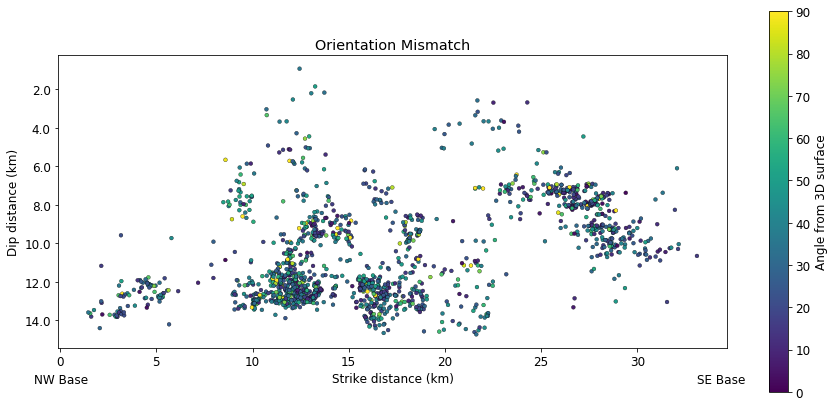

In [55]:
# Figure 6a
### ! the dip distance has flipped since previous submission: 02012020, as well as the distance being multiplied by -1
matplotlib.rcParams.update({'font.size': 12})
boo = unmodified.focalAvailable
plt.figure(figsize=(15,7))
plt.axes().set_aspect('equal')

x = (unmodified.pS[boo]-np.amin(unmodified.pS) )/1000
y = (unmodified.pD[boo]-np.amin(unmodified.pD) )/1000

plt.scatter(x, y, c=unmodified.thetaLeast*180/np.pi,
        vmin = 0, vmax = 90, linewidths=.3, edgecolors='k',
           s = 15)#3**mag)

shiftylabel = -2
plt.text(np.amin(x), np.amin(y)+shiftylabel, 'NW Base', 
         verticalalignment = 'top',
         horizontalalignment = 'right')
plt.text(np.amax(x), np.amin(y)+shiftylabel, 'SE Base', 
         verticalalignment = 'top',
         horizontalalignment = 'left')

cbar = plt.colorbar()
cbar.set_label('Angle from 3D surface')
plt.xlabel('Strike distance (km)')
plt.ylabel('Dip distance (km)')
plt.title('Orientation Mismatch')

ax = plt.gca()
labels = ax.get_yticks().tolist() # Manually flip the yaxis so the origin is at top of fault, not bottom
labels.reverse()
ax.set_yticklabels(labels)

plt.savefig('figures/orient_scatter.jpg', dpi = 400)

plt.show()

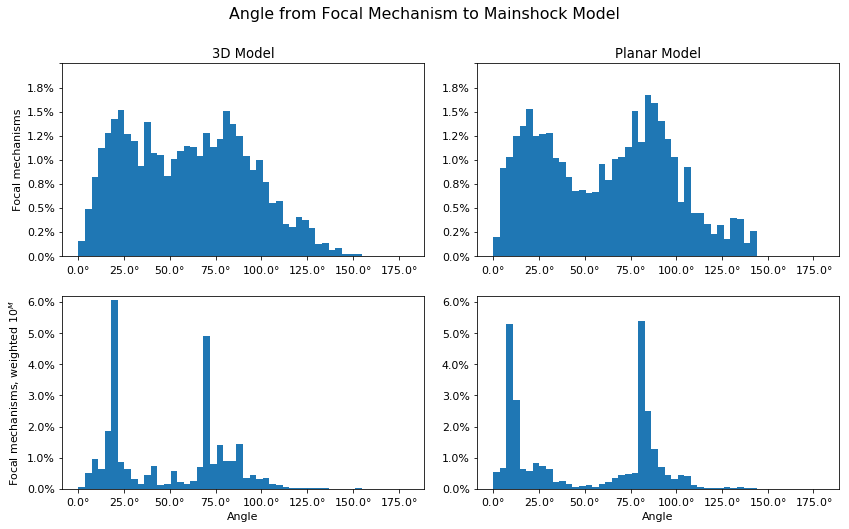

In [56]:
# Figure 6b

matplotlib.rcParams.update({'font.size': 11})
fig, axs = plt.subplots(2, 2, figsize=(12,7))

numbins = 50 

axs[0, 0].hist(
    np.array([unmodified.theta1[bN], unmodified.theta2[bN]]).ravel()*180/np.pi, 
         bins = numbins, range=(0, 180), density = True # 
        )
axs[0, 1].hist(np.array([planeVsSurface.theta1[bN], planeVsSurface.theta2[bN]]).ravel()*180/np.pi, 
         bins = numbins, range=(0, 180), density = True
        )
axs[1,0].hist(np.array([unmodified.theta1[bN], unmodified.theta2[bN]]).ravel()*180/np.pi, 
         bins = numbins, range=(0, 180), density=True,
         weights=np.array([weights[bN], weights[bN]]).ravel()
         )
axs[1,1].hist(np.array([planeVsSurface.theta1[bN], planeVsSurface.theta2[bN]]).ravel()*180/np.pi, 
         bins = numbins, range=(0, 180), density = True,
         weights=np.array([weights[bN], weights[bN]]).ravel()
        )

rangeTopFig = (0, .016)
rangeBotFit = (0, .062)
for i in range(2):
    axs[0, i].set_ylim(rangeTopFig)
for i in range(2):
    axs[1, i].set_ylim(rangeBotFit)

# for i in range(2): 
#     for j in range(2):
#         axs[i, j].tick_params(labelleft=False) 

for i in range(2): 
    for j in range(2):
        ax = axs[i, j]
        vals = ax.get_yticks()
        ax.set_yticklabels(['{:,.1%}'.format(x) for x in vals])

axs[0,0].set_title('3D Model', y = 1)
axs[0,1].set_title('Planar Model', y = 1)

for i in range(2):
    axs[1, i].set_xlabel('Angle')
    
axs[0, 0].set_ylabel('Focal mechanisms')
axs[1, 0].set_ylabel('Focal mechanisms, weighted $10^{M}$')

for i in range(axs.shape[0]):
    for j in range(axs.shape[1]):
        axs[i, j].set_xticklabels(['{:.1f}$\degree$'.format(x) for x in plt.gca().get_xticks()])

plt.tight_layout(pad = 1.3)
fig.suptitle("Angle from Focal Mechanism to Mainshock Model", fontsize="x-large", y = 1.05)
plt.savefig('figures/orient_hist.jpg', dpi = 400)
plt.show()

## Figure 6. 
Angular mismatch between the normal vectors of the
interpolated fault surface and the normal vectors of the available
earthquake focal mechanisms. (a) Angular mismatch compared to location
of hypocenters in the cluster that corresponds to the Paganica fault.
Earthquake locations are plotted according to their distance along
strike and along dip on the fault surface. Only the best matching angle
for each aftershock is used for (a). (b) Histograms showing the number
of focal planes with any given angular mismatch (top) weighted by 10^M^
(bottom). We show both our 3D fault model (left panels) and the planar
model used in Cirella et al. (2012) (right panels). Both focal planes of
each focal mechanism were included in (b). This results in alignment
peaks near 90° that correspond with the auxiliary planes of focal
mechanisms. For the fault planes of the focal mechanisms, alignment
peaks are closer to 20°. Orientation match is improved when using the
magnitude as a weight.

# 𝟒. Discussion and Conclusions 

There is a need to develop and improve algorithms which can find the 3D
morphology of faults. The primary purpose here is to explore a new
algorithm to do so which is fast and objective and to investigate the
utility of machine learning for this purpose. We used successive
iterations of clustering to construct a quantitative model of the fault
segments associated with the L'Aquila seismic sequence. The approach,
based on a combination of spectral and DBSCAN clustering, provides
several advantages. The method can be applied in only a few seconds on a
standard laptop, saving time in the case of analyzing a seismic sequence
in real time, while it is also objective in its determination of faults.
In this way, it provides advantages over the high-resolution options of
manual fault interpolation. It is advantageous over planar clustering
approaches in that it estimates the continuous first order geometry of a
fault zone. Curved faults, for instance the listric Campotosto fault,
can thus be represented with one cluster (Figure 3). Using planar
clustering, a curved fault would instead be represented with several
disconnected planes (e.g. Wang et al., 2013) which complicates modelling
the rupture of a mainshock along its entire extent. Our approach is
further advantageous over algorithms which cluster based on the
distribution of points around each cluster's average point, such as
k-means, which would find diffuse clouds of seismicity that are suitable
for methods which are not dependent on fault morphology (Weatherill and
Burton, 2009).

## 4.1 Parameter choice 

Although the algorithm is objective, the parameter choices (Table 1)
require care as these can have important influences on the results. The
reader can experiment with different parameter choices in the
Supplementary Jupyter Notebook.

For our application of DBSCAN, the choice of Eps, MinPts, and
$\text{f\ }$requires human supervision. By decreasing $f$, DBSCAN
incorporates hypocenters which are more widely distributed about faults
and it tends to group multiple faults together. However, by changing
MinPts and Eps to reflect different values of $f$, similar results to
our final clusters can be ultimately obtained. We showed an example of
our Paganica cluster and fault using $f = 5$ (figures 3-5) and $f = 1$
(Figure S2). Figure S3 shows the influence of Eps and MinPts on the
Paganica hypocenter cluster. Increasing MinPts increases the tendency to
reject potential clusters as noise, resulting in fewer and smaller
clusters, and specifically reducing the number of hypocenters in the
Paganica cluster. Increasing Eps increases the tendency for hypocenters
to be clustered together, potentially merging faults together, and
increasing the number of hypocenters in the Paganica hypocenter cluster.
We performed a grid test to quantify the influence of Eps and MinPts
(Figure S3). Variations of the parameters about our chosen values did
not impart important changes to the Paganica cluster which consistently
had approximately the same 29367 hypocenters. Because of this, the
parameters do not necessarily need fine tuning as a wide variety of
parameters produce similar results.

The choice of spectral clustering parameters is slightly less crucial
here, as it is primarily used for preliminary data operations which are
designed to make DBSCAN clustering more successful. The spectral
clustering step requires prior knowledge of the number of major
hypocenter clusters. We chose three based on visual inspection and trial
and error; increasing the number of clusters broke the Paganica fault up
along strike which could also be acceptable based on several other
Paganica fault system models having smaller distance along strike (e.g.
Vannoli et al., 2012). Sigma was tuned manually to maintain maximal
separation between the three dominant clusters (Figure S1). However, for
$1250\ \mathrm{m} < \sigma < \ 4300\ \mathrm{m}$, the results varied
only negligibly.

## 4.2 Implications for fault structure 

We identified key hypocenter clusters in part according to which
geologically identified fault segment they most closely correspond to.
However, there are important differences between the hypocenter clusters
and faults. Clustering will be blind to portions of faults which were
never activated. Thus, the true maximum extent of a fault can be greater
than indicated by the hypocenter clusters. Similarly, for separate
faults which are coherent with each other in space and shape, clustering
may indicate these as being the same fault. This is why our fault model
is longer at its base than most other fault models, at \~34.0 km.
Clustering does not discriminate in accordance with fault identification
made geologically at fine scales, but rather identifies coherent
hypocenters. While this may not be desirable for recognizing geological
structures on fine scales, it can be more appropriate for modelling
earthquakes where rupture is not confined to a single fault plane (e.g.
Tondi, 2000; Civico et al., 2017).

We tested the quality of the interpolated Paganica fault surface through
several approaches. One approach was to find how well the interpolated
fault surface matches the orientation of the earthquakes that it
interpolates (Figure 6). When comparing the match of aftershock
orientations to our 3D model and a 2D model (Cirella et al., 2012),
there does not appear to be an improvement moving from the planar model
to our 3D surface. This is probably due to the fact that the L'Aquila
mainshock ruptured on a relatively planar fault segment. Faults with
more curvature, such as the Campotosto fault, will likely show more
certain improvement by incorporating 3D morphology.

While ideally the aftershock orientations should have matched the 3D
fault surface model well, when comparing the mismatch with each
aftershock weighted equally, the aftershock orientations only mildly
agree with either the planar model or 3D model (Figure 6). However, when
the magnitude of aftershocks (10^M^) is used as a weight, the match
between aftershocks and the 3D Paganica fault model increases. This
suggests that larger earthquakes are more closely aligned with their
fault surface and/or the focal mechanisms of smaller events are more
poorly constrained. Another plausible reason could be that some
aftershocks may have been associated with conjugate faults instead of
the main fault surface (Figure 5b). There may be more unnoticed, smaller
conjugate faults as well.

However, the misalignment between the fault model and focal mechanisms
may have implications for the structure of the fault. Fault structures
can become very complex with damage zones involving various scales and
patterns (Peacock and Sanderson, 1991; Valoroso et al., 2014), and
aftershock clusters often occur at the most complex regions of a fault
surface where damage zones are the most extreme (Sibson 1989; Kim and
Sanderson, 2008; Michele et al., 2020). Not only damage zones, but also
the complexity of fault connectivity provides a means for aftershocks to
rupture in directions and locations not in agreement with the main fault
surface. One model for fault growth requires several smaller faults to
link together, for instance through the breaching of relay ramps, in
order to form larger faults (Childs et al., 2009). This results in
complex rupture geometries. Relay ramps allow for a fault to be
connected by many discontinuous faults at small and large scales. Relays
have indeed been observed on surface expressions of the Paganica fault
(Roberts et al., 2010). Faults can also be connected by extensional
steps and contractional steps (Kim, peacock, and Sanderson, 2004). The
tips of a fault can be particularly complex as well. Where fault
displacement dies out at the tips of faults, displacement tends to end
in splays (Kim, Peacock, and Sanderson, 2004). Splaying has been
observed in the Paganica fault geologically (Cinti et al., 2011) and
seismically (Chiaraluce et al., 2011). Given these issues, and that we
are modelling a fault zone as a single 3D surface, we expect
discontinuous sections of the fault zone to contain aftershocks which
align poorly to the main fault surface.

## 4.3 Future directions 

This approach could aid in seismic hazard assessment. Most models of
stress transfer that address aftershocks in the L'Aquila seismic
sequence rely on flat fault models (e.g. Serpelloni et al., 2012).
However, the 3D morphology of the mainshock as well as any recipient
faults will influence this stress and earthquake interaction,
influencing the development of earthquake sequences (Mildon et al.,
2016; Kaven and Pollard, 2013). Our 3D fault model can be used as the
basis for a 3D mainshock geometry, and the slip distribution can be
inverted using geodetic or waveform data (e.g. Kaven and Pollard, 2013;
Castaldo et al., 2018). This approach may illuminate important
foreshock-mainshock or mainshock-aftershock interactions that are
otherwise not clear.

This method can be applied to other seismic sequences. The L'Aquila
sequence itself is just one part of a larger extensional fault system
that has experienced several recent seismic sequences extending over
more than 150 km. This includes the 1979 Umbria sequence, the 1997
Colfiorito sequence, and the 2016 Amatrice/Visso/Norcia sequence. Other
locations where seismicity is thoroughly monitored, for instance
throughout California, could be good sites to apply this technique.
Further, applying this method to faults in developing seismic sequences
could help illuminate locked zones where a region of a fault experiences
seismic quiescence but is surrounded by an active portion of the fault
(Avouac et al., 2015).

## Acknowledgements

We thank Raphael Gottardi, Carl Richter, and Martin Mai for helpful
comments and advice on writing. We thank Antonella Cirella, Olaf Zielke,
and Mehdi Nikkhoo for giving guidance on completing the code. We thank
two anonymous reviewers for helping to improve the manuscript. 3D
figures were made and provided interactively using Plotly
(<https://plotly.com/>).

The Python code for this work is written in Jupyter Notebooks (Kluyver
et al., 2016; Morra, 2018) where the interactive code is embedded within
the manuscript. This is available in GitHub
(<https://github.com/brennanbrunsvik/Fault-morphology-clustering>) where
it can be ran through the cloud service Binder. Online interactive 3D
figures are available as well for the clustering and fault model as
supplemental html files and online (https://bit.ly/2MnCFdj).

# References

Ansari, A., Firuzi, E., Etemadsaeed, L., 2015. Delineation of Seismic
Sources in Probabilistic Seismic‐Hazard Analysis Using Fuzzy Cluster
Analysis and Monte Carlo Simulation. Bulletin of the Seismological
Society of America. 105, 2174-2191.

Avouac, J. P., 2008. Dynamic processes in extensional and compressional
settings-mountain building: from earthquakes to geological deformation.
Treatise on geophysics. 6, 377-439.

Avouac, J. P., Meng, L., Wei, S., Wang, T., Ampuero, J. P., 2015. Lower
edge of locked Main Himalayan Thrust unzipped by the 2015 Gorkha
earthquake. Nature Geoscience. 8.

Barka, A. A., Kadinsky‐Cade, K., 1988. Strike‐slip fault geometry in
Turkey and its influence on earthquake activity. Tectonics. 7, 663-684.

Ben-Zion, Y., Peng, Z., Okaya, D., Seeber, L., Armbruster, J. G., Ozer,
N., \... Aktar, M.,2003. A shallow fault-zone structure illuminated by
trapped waves in the Karadere--Duzce branch of the North Anatolian
Fault, western Turkey. Geophysical Journal International. 152, 699-717.

Bergen, K. J., Johnson, P. A., Maarten, V., Beroza, G. C., 2019. Machine
learning for data-driven discovery in solid Earth geoscience. Science.
363, eaau0323.

Bletery, Q., Thomas, A. M., Rempel, A. W., Karlstrom, L., Sladen, A., De
Barros, L., 2016. Mega-earthquakes rupture flat megathrusts. Science.
354, 1027-1031.

Boncio, P., Pizzi, A., Brozzetti, F., Pomposo, G., Lavecchia, G., Di
Naccio, D., Ferrarini, F., 2010. Coseismic ground deformation of the 6
April 2009 L\'Aquila earthquake (central Italy, Mw6. 3). Geophysical
Research Letters. 37.

Calderoni, G., Di Giovambattista, R., Vannoli, P., Pucillo, S., Rovelli,
A., 2012. Fault-trapped waves depict continuity of the fault system
responsible for the 6 April 2009 Mw 6.3 L\'Aquila earthquake, central
Italy. Earth and Planetary Science Letters. 323, 1-8.

Carena, S., Suppe, J., 2002. Three-dimensional imaging of active
structures using earthquake aftershocks: the Northridge thrust,
California. Journal of Structural Geology. 24, 887-904.

Carena, S., Suppe, J., Kao, H., 2002. Active detachment of Taiwan
illuminated by small earthquakes and its control of first-order
topography. Geology. 30, 935-938.

Castaldo, R., De Nardis, R., DeNovellis, V., Ferrarini, F., Lanari, R.,
Lavecchia, G., \..., Tizzani, P., 2018. Coseismic Stress and Strain
Field Changes Investigation Through 3‐D Finite Element Modeling of
DInSAR and GPS Measurements and Geological/Seismological Data: The
L\'Aquila (Italy) 2009 Earthquake Case Study. Journal of Geophysical
Research: Solid Earth. 123, 4193-4222.

Chiaraluce, L., 2012. Unravelling the complexity of Apenninic
extensional fault systems: A review of the 2009 L\'Aquila earthquake
(Central Apennines, Italy). Journal of Structural Geology. 42, 2-18.

Chiaraluce, L., De Gori, P., Di Stefano, R., Valoroso, L., 2021. L'Aquila
2009 seismic sequence: integrated dataset of automatic first motion 
polarities focal mechanisms and RMT with HypoDD high quality relative 
earthquake locations (Version 1.0). Zenodo.
http://doi.org/10.5281/zenodo.4024065

Chiaraluce, L., Valoroso, L., Piccinini, D., Di Stefano, R., De Gori,
P., 2011. The anatomy of the 2009 L\'Aquila normal fault system (central
Italy) imaged by high resolution foreshock and aftershock locations.
Journal of Geophysical Research: Solid Earth. 116.

Childs, C., Manzocchi, T., Walsh, J. J., Bonson, C. G., Nicol, A.,
Schöpfer, M. P., 2009. A geometric model of fault zone and fault rock
thickness variations. Journal of Structural Geology. 31, 117-127.

Cinti, F. R., Pantosti, D., De Martini, P. M., Pucci, S., Civico, R.,
Pierdominici, S., \..., Patera, A., 2011. Evidence for surface faulting
events along the Paganica fault prior to the 6 April 2009 L\'Aquila
earthquake (central Italy). Journal of Geophysical Research: Solid
Earth. 116.

Cirella, A., Piatanesi, A., Tinti, E., Chini, M., Cocco, M., 2012.
Complexity of the rupture process during the 2009 L\'Aquila, Italy,
earthquake. Geophysical Journal International. 190, 607-621.

Civico, R., Pucci, S., De Martini, P. M., Pantosti, D., 2015.
Morphotectonic analysis of the long-term surface expression of the 2009
L\'Aquila earthquake fault (Central Italy) using airborne LiDAR data.
Tectonophysics. 644, 108-121.

Civico, R., Sapia, V., Di Giulio, G., Villani, F., Pucci, S.,
Baccheschi, P., \... & Pantosti, D., 2017. Geometry and evolution of a
fault‐controlled Quaternary basin by means of TDEM and single‐station
ambient vibration surveys: The example of the 2009 L\'Aquila earthquake
area, central Italy. Journal of Geophysical Research: Solid Earth. 122,
2236-2259.

Custódio, S., Lima, V., Vales, D., Cesca, S., Carrilho, F., 2016.
Imaging active faulting in a region of distributed deformation from the
joint clustering of focal mechanisms and hypocentres: Application to the
Azores--western Mediterranean region. Tectonophysics. 676, 70-89.

Dzwinel, W., Yuen, D. A., Boryczko, K., Ben-Zion, Y., Yoshioka, S., &
Ito, T., 2005. Cluster analysis, data-mining, multi-dimensional
visualization of earthquakes over space, time and feature
space. Nonlinear Processes in Geophysics. 12, 117-128.

Dzwinel, W., Yuen, D., Kaneko, Y., Boryczko, K., & Ben-Zion, Y., 2003.
Multi-resolution clustering analysis and 3-D visualization of
multitudinous synthetic earthquakes. Visual Geosciences. *8*, 1-32.

EMERGEO Working Group., 2010. Evidence for surface rupture associated
with the Mw 6.3 L'Aquila earthquake sequence of April 2009 (central
Italy). Terra Nova. 22, 43-51.

Ester, M., Kriegel, H. P., Sander, J., Xu, X., 1996. A density-based
algorithm for discovering clusters in large spatial databases with
noise. Kdd. 96, 226-231.

Fischler, M. A., Bolles, R. C., 1981. Random sample consensus: a
paradigm for model fitting with applications to image analysis and
automated cartography. Communications of the ACM. 24, 381-395.

Fornberg, B., Zuev, J., 2007. The Runge phenomenon and spatially
variable shape parameters in RBF interpolation. Computers & Mathematics
with Applications. 54, 379-398.

Galvez, P., Ampuero, J. P., Dalguer, L. A., Somala, S. N., Nissen-Meyer,
T., 2014. Dynamic earthquake rupture modelled with an unstructured 3-D
spectral element method applied to the 2011 M 9 Tohoku earthquake.
Geophysical Journal International. 198, 1222-1240.

Hall, T. R., Nixon, C. W., Keir, D., Burton, P. W., Ayele, A., 2018.
Earthquake Clustering and Energy Release of the African--Arabian Rift
System. Bulletin of the Seismological Society of America. 108, 155-162.

Hubbard, J., Almeida, R., Foster, A., Sapkota, S. N., Bürgi, P.,
Tapponnier, P., 2016. Structural segmentation controlled the 2015 Mw 7.8
Gorkha earthquake rupture in Nepal. Geology. 44, 639-642.

Virtanen, P., Gommers, R., Oliphant, T. E., Haberland, M., Reddy, T.,
Cournapeau, D., \... van Mulbregt, P., 2020. SciPy 1.0: fundamental
algorithms for scientific computing in Python. Nature methods. 17,
261-272.

Joshi, A., Kaur, R., 2013. A review: Comparative study of various
clustering techniques in data mining. International Journal of Advanced
Research in Computer Science and Software Engineering. 3.

Kaven, J. O., Pollard, D. D., 2013. Geometry of crustal faults:
Identification from seismicity and implications for slip and stress
transfer models. Journal of Geophysical Research: Solid Earth. 118,
5058-5070.

Kim, Y. S., Peacock, D. C., Sanderson, D. J., 2004. Fault damage zones.
Journal of structural geology. 26, 503-517.

Kim, Y. S., Sanderson, D. J., 2008. Earthquake and fault propagation,
displacement and damage zones. Structural Geology: New Research. 1,
99-117.

Kluyver, T., Ragan-Kelley, B., Pérez, F., Granger, B. E., Bussonnier,
M., Frederic, J., \..., Ivanov, P., 2016. Jupyter Notebooks-a publishing
format for reproducible computational workflows. ELPUB. 87-90.

Kong, Q., Trugman, D. T., Ross, Z. E., Bianco, M. J., Meade, B. J.,
Gerstoft, P., 2019. Machine Learning in Seismology: Turning Data into
Insights. Seismological Research Letters. 90, 3-14.

Landry, W., Barbot, S., 2018. Fast, accurate solutions for curvilinear
earthquake faults and anelastic strain. arXiv preprint arXiv:1802.08931.

Lavecchia, G., Adinolfi, G. M., de Nardis, R., Ferrarini, F., Cirillo,
D., Brozzetti, F., \..., Zollo, A., 2017. Multidisciplinary inferences
on a newly recognized active east‐dipping extensional system in Central
Italy. Terra Nova. 29, 77-89.

Lavecchia, G., Castaldo, R., De Nardis, R., De Novellis, V., Ferrarini,
F., Pepe, S., \..., Boncio, P., 2016. Ground deformation and source
geometry of the 24 August 2016 Amatrice earthquake (Central Italy)
investigated through analytical and numerical modeling of DInSAR
measurements and structural‐geological data. Geophysical Research
Letters. 43, 12-389.

Lavecchia, G., Ferrarini, F., Brozzetti, F., De Nardis, R., Boncio, P.,
Chiaraluce, L., 2012. From surface geology to aftershock analysis:
Constraints on the geometry of the L'Aquila 2009 seismogenic fault
system. Italian Journal of Geosciences. 131, 330-347.

Lohr, T., Krawczyk, C. M., Oncken, O., Tanner, D. C., 2008. Evolution of
a fault surface from 3D attribute analysis and displacement
measurements. Journal of Structural Geology. 30, 690-700.

Mancini, S., Segou, M., Werner, M. J., Cattania, C., 2019. Improving
physics‐based aftershock forecasts during the 2016--2017 Central Italy
Earthquake Cascade. Journal of Geophysical Research: Solid Earth. 124,
8626-8643.

Michele, M., Chiaraluce, L., Di Stefano, R., Waldhauser, F., 2020.
Fine‐Scale Structure of the 2016--2017 Central Italy Seismic Sequence
From Data Recorded at the Italian National Network. Journal of
Geophysical Research: Solid Earth. 125.

Mildon, Z. K., Toda, S., Faure Walker, J. P., Roberts, G. P., 2016.
Evaluating models of Coulomb stress transfer: Is variable fault geometry
important? Geophysical Research Letters. 43, 12-407.

Moore, G. F., Bangs, N. L., Taira, A., Kuramoto, S., Pangborn, E.,
Tobin, H. J., 2007. Three-dimensional splay fault geometry and
implications for tsunami generation. Science. 318, 1128-1131.

Morra, G., 2018. Pythonic Geodynamics. Lecture Notes in Earth System
Sciences.

Mousavi, S. M., Beroza, G. C., 2019. A Machine‐Learning Approach for
Earthquake Magnitude Estimation. Geophysical Research Letters. 47.

Novianti, P., Setyorini, D., Rafflesia, U., 2017. K-Means cluster
analysis in earthquake epicenter clustering. International Journal of
Advances in Intelligent Informatics. 3, 81-89.

Omran, M. G., Engelbrecht, A. P., Salman, A., 2007. An overview of
clustering methods. Intelligent Data Analysis. 11, 583-605.

Ouillon, G., Ducorbier, C., Sornette, D., 2008. Automatic reconstruction
of fault networks from seismicity catalogs: Three‐dimensional optimal
anisotropic dynamic clustering. Journal of Geophysical Research: Solid
Earth. 113.

Ouillon, G., Sornette, D, 2011. Segmentation of fault networks
determined from spatial clustering of earthquakes. Journal of
Geophysical Research: Solid Earth. 116.

Peacock, D. C. P., Sanderson, D. J., 1991. Displacements, segment
linkage and relay ramps in normal fault zones. Journal of Structural
Geology. 13, 721-733.

Pedregosa, F., Varoquaux, G., Gramfort, A., Michel, V., Thirion, B.,
Grisel, O., \..., Vanderplas, J., 2011. Scikit-learn: Machine learning
in Python. Journal of machine learning research. 12, 2825-2830.

Pelties, C., Puente, J., Ampuero, J. P., Brietzke, G. B., Käser, M.,
2012. Three‐dimensional dynamic rupture simulation with a high‐order
discontinuous Galerkin method on unstructured tetrahedral meshes.
Journal of Geophysical Research: Solid Earth. 117.

Peng, Z., Ben-Zion, Y., Michael, A. J., Zhu, L., 2003. Quantitative
analysis of seismic fault zone waves in the rupture zone of the 1992
Landers, California, earthquake: evidence for a shallow trapping
structure. Geophysical Journal International. 155, 1021-1041.

Prautzsch, H., Boehm, W., Paluszny, M., 2002. Bézier and B-spline
techniques. Springer Science & Business Media.

Qiu, Q., Hill, E. M., Barbot, S., Hubbard, J., Feng, W., Lindsey, E. O.,
\..., Tapponnier, P., 2016. The mechanism of partial rupture of a locked
megathrust: The role of fault morphology. Geology. 44, 875-878.

Ragon, T., Sladen, A., Simons, M., 2018. Accounting for uncertain fault
geometry in earthquake source inversions--I: theory and simplified
application. Geophysical Journal International. 214, 1174-1190.

Rietbrock, A., Tiberi, C., Scherbaum, F., Lyon‐Caen, H., 1996. Seismic
slip on a low angle normal fault in the Gulf of Corinth: Evidence from
high‐resolution cluster analysis of microearthquakes. Geophysical
Research Letters. 23, 1817-1820.

Roberts, G. P., Raithatha, B., Sileo, G., Pizzi, A., Pucci, S., Walker,
J. F., \..., Guerrieri, L., 2010. Shallow subsurface structure of the
2009 April 6 M w 6.3 L\'Aquila earthquake surface rupture at Paganica,
investigated with ground-penetrating radar. Geophysical Journal
International. 183, 774-790.

Rouet‐Leduc, B., Hulbert, C., Lubbers, N., Barros, K., Humphreys, C. J.,
Johnson, P. A., 2017. Machine learning predicts laboratory earthquakes.
Geophysical Research Letters. 44, 9276-9282.

Røe, P., Georgsen, F., Abrahamsen, P., 2014. An uncertainty model for
fault shape and location. Mathematical Geosciences. 46, 957-969.

Schubert, E., Sander, J., Ester, M., Kriegel, H. P., Xu, X., 2017.
DBSCAN revisited, revisited: why and how you should (still) use DBSCAN.
ACM Transactions on Database Systems (TODS). 42, 1-21.

Scitovski, S., 2018. A density-based clustering algorithm for earthquake
zoning. Computers & Geosciences. 110, 90-95.

Scognamiglio, L., Tinti, E., Michelini, A., Dreger, D. S., Cirella, A.,
Cocco, M., \..., Piatanesi, A., 2010. Fast determination of moment
tensors and rupture history: What has been learned from the 6 April 2009
L\'Aquila earthquake sequence. Seismological Research Letters. 81,
892-906.

Skoumal, R. J., Kaven, J. O., Walter, J. I., 2019. Characterizing
seismogenic fault structures in Oklahoma using a relocated
template‐matched catalog. Seismological Research Letters. 90, 1535-1543.

Serpelloni, E., Anderlini, L., Belardinelli, M. E., 2012. Fault
geometry, coseismic-slip distribution and Coulomb stress change
associated with the 2009 April 6, M W 6.3, L′ Aquila earthquake from
inversion of GPS displacements. Geophysical Journal International. 188,
473-489.

Sibson, R. H., 1989. Earthquake faulting as a structural process.
Journal of Structural Geology. 11, 1-14.

Tondi, E., 2000. Geological analysis and seismic hazard in the central
Apennines (Italy). Journal of Geodynamics. 29, 517-533.

Trugman, D. T., Shearer, P. M., 2017. GrowClust: A hierarchical
clustering algorithm for relative earthquake relocation, with
application to the Spanish Springs and Sheldon, Nevada, earthquake
sequences. Seismological Research Letters. 88, 379-391.

Tung, S., Masterlark, T., 2018. Resolving Source Geometry of the 24
August 2016 Amatrice, Central Italy, Earthquake from InSAR Data and 3D
Finite‐Element ModelingResolving Source Geometry of the 2016 Amatrice
Earthquake from InSAR Data and 3D FEMs. Bulletin of the Seismological
Society of America. 108, 553-572.

Valoroso, L., Chiaraluce, L., Collettini, C., 2014. Earthquakes and
fault zone structure. Geology. 42, 343-346.

Valoroso, L., Chiaraluce, L., Piccinini, D., Di Stefano, R., Schaff, D.,
Waldhauser, F., 2013. Radiography of a normal fault system by 64,000
high‐precision earthquake locations: The 2009 L\'Aquila (central Italy)
case study. Journal of Geophysical Research: Solid Earth. 118,
1156-1176.

Valoroso, L., Chiaraluce, L., Piccinini, D., Di Stefano, R., Schaff, D.,
Waldhauser, F., 2013. Radiography of a normal fault system by 64,000
high‐precision earthquake locations. (Version Version 1.0) [Data set]. Zenodo. http://doi.org/10.5281/zenodo.4036248

Vannoli, P., Burrato, P., Fracassi, U., Valensise, G., 2012. A fresh
look at the seismotectonics of the Abruzzi (Central Apennines) following
the 6 April 2009 L'Aquila earthquake (Mw 6.3). Italian Journal of
Geosciences. 131, 309-329.

Verdecchia, A., Pace, B., Visini, F., Scotti, O., Peruzza, L.,
Benedetti, L., 2018. The role of viscoelastic stress transfer in
long‐term earthquake cascades: Insights after the central Italy
2016--2017 seismic sequence. Tectonics. 37, 3411-3428.

Von Luxburg, U., 2007. A tutorial on spectral clustering. Statistics and
computing. 17, 395-416.

Waldhauser, F., Ellsworth, W. L., 2000. A double-difference earthquake
location algorithm: Method and application to the northern Hayward
fault, California. Bulletin of the Seismological Society of America. 90,
1353-1368.

Wang, Y., Ouillon, G., Woessner, J., Sornette, D., Husen, S., 2013.
Automatic reconstruction of fault networks from seismicity catalogs
including location uncertainty. Journal of Geophysical Research: Solid
Earth. 118, 5956-5975.

Weatherill, G., Burton, P. W., 2009. Delineation of shallow seismic
source zones using K-means cluster analysis, with application to the
Aegean region. Geophysical Journal International. 176, 565-588.

Yuen, D. A., Dzwinel, W., Ben-Zion, Y., & Kadlec, B., 2009.
Visualization of earthquake clusters over multidimensional
space. Encyclopedia of Complexity and Systems Science. 2347-2371.

Zhang, Z., Zhang, W., Chen, X., 2014. Three-dimensional curved grid
finite-difference modelling for non-planar rupture dynamics. Geophysical
Journal International. 199, 860-879.

Zhu, W., Beroza, G. C., 2019. PhaseNet: a deep-neural-network-based
seismic arrival-time picking method. Geophysical Journal International.
216, 261-273.

Zielke, O., Galis, M., Mai, P. M., 2017. Fault roughness and strength
heterogeneity control earthquake size and stress drop. Geophysical
Research Letters. 44, 777-783.
